<b> Exploring data on zomato dataset </b>

In [1]:
#importing libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
plt.style.use('ggplot')
from wordcloud import WordCloud
import plotly.graph_objs as go
import plotly.offline as py
import plotly.figure_factory as ff
from plotly import tools
from plotly.offline import download_plotlyjs,init_notebook_mode,plot,iplot
init_notebook_mode(connected=True)
import plotly_express as px
import warnings 
warnings.filterwarnings('ignore')

<b> importing the data </b>

In [2]:
rest_data = pd.read_csv('zomato.csv')

In [3]:
print("The dataset containts",rest_data.shape[0],"number of resturants")

The dataset containts 51717 number of resturants


In [4]:
rest_data.head(2)

,url,address,name,online_order,book_table,rate,votes,phone,location,rest_type,dish_liked,cuisines,approx_cost(for two people),reviews_list,menu_item,listed_in(type),listed_in(city)
0,https://www.zomato.com/bangalore/jalsa-banasha...,"942, 21st Main Road, 2nd Stage, Banashankari, ...",Jalsa,Yes,Yes,4.1/5,775,080 42297555\r\n+91 9743772233,Banashankari,Casual Dining,"Pasta, Lunch Buffet, Masala Papad, Paneer Laja...","North Indian, Mughlai, Chinese",800,"[('Rated 4.0', 'RATED\n A beautiful place to ...",[],Buffet,Banashankari
1,https://www.zomato.com/bangalore/spice-elephan...,"2nd Floor, 80 Feet Road, Near Big Bazaar, 6th ...",Spice Elephant,Yes,No,4.1/5,787,080 41714161,Banashankari,Casual Dining,"Momos, Lunch Buffet, Chocolate Nirvana, Thai G...","Chinese, North Indian, Thai",800,"[('Rated 4.0', 'RATED\n Had been here for din...",[],Buffet,Banashankari


<b> Performing data cleansing </b>

In [5]:
del rest_data['url']

In [6]:
del rest_data['address']

In [8]:
del rest_data['phone']

In [9]:
del rest_data['location']

In [10]:
#renaming some column for better readability 
rest_data.rename(columns = {'listed_in(city)':'Suburb','listed_in(type)':'resturant_type'},inplace=True)

In [11]:
rest_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 51717 entries, 0 to 51716
Data columns (total 13 columns):
name                           51717 non-null object
online_order                   51717 non-null object
book_table                     51717 non-null object
rate                           43942 non-null object
votes                          51717 non-null int64
rest_type                      51490 non-null object
dish_liked                     23639 non-null object
cuisines                       51672 non-null object
approx_cost(for two people)    51371 non-null object
reviews_list                   51717 non-null object
menu_item                      51717 non-null object
resturant_type                 51717 non-null object
Suburb                         51717 non-null object
dtypes: int64(1), object(12)
memory usage: 5.1+ MB


In [12]:
"""We can see that there are some missing values in Votes, which means that not enough paeople have given their ratings for that particular restaurant, thus a consolidated rating is not available. Replacing all the null values in votes with 'Newly Opened'."""

rest_data.rate = rest_data.rate.replace(np.nan,'Newly Opened')

<b> Lets start with Data Vizualization </b>

<u>1.Total number of resturant in each suburban locality of the city</u>

In [13]:
trace1 = go.Bar(x=rest_data.Suburb.value_counts().keys(),y=rest_data.Suburb.value_counts(), name='Suburb',text=rest_data.Suburb)
data1 = [trace1]
layout = go.Layout(title='Resturant distribution by suburb',barmode='group',yaxis=dict(title='Number of resturant'))
fig = go.Figure(data=data1,layout=layout)
py.offline.iplot(fig,filename='basic-line')

<u> 2. Distribution of resturants by resturant types </u>

In [14]:
trace1 = go.Bar(x=rest_data.resturant_type.value_counts().keys(),y=rest_data.resturant_type.value_counts(), name='resturant_type',text=rest_data.resturant_type)
data1 = [trace1]
layout = go.Layout(title='Resturant distribution by Type',barmode='group',yaxis=dict(title='Number of resturants'))
fig = go.Figure(data=data1,layout=layout)
py.offline.iplot(fig,filename='basic-line')

<u> 3.Distribution of the resturant by sub categories </u>

In [15]:
trace1 = go.Bar(x=rest_data.rest_type.value_counts().head(15).keys(),y=rest_data.rest_type.value_counts().head(15), name='rest_type',text=rest_data.rest_type)
data1 = [trace1]
layout = go.Layout(title='Resturant distribution by Sub-categories',barmode='group',yaxis=dict(title='Number of resturants'))
fig = go.Figure(data=data1,layout=layout)
py.offline.iplot(fig,filename='basic-line')

<u>4. Resturant accepting online orders </u>

In [19]:
x = rest_data['online_order'].value_counts()
trace = go.Pie(labels = x.index,values = x)
layout = go.Layout(title = 'Online order')
fig = go.Figure(data=[trace],layout= layout)
py.iplot(fig,filename='pie_OnlineOrder')

<u>5. How many of them allow advance booking of tables </u>

In [18]:
x = rest_data['book_table'].value_counts()
trace = go.Pie(labels = x.index,values = x)
layout = go.Layout(title = 'Book Table')
fig = go.Figure(data=[trace],layout= layout)
py.iplot(fig,filename='pie_bookTable')

<u>6. Resturant Rating vs Cost for Two </u>

In [21]:
trace = go.Scatter(y=rest_data['approx_cost(for two people)'],text = rest_data['name'],mode='markers',x=rest_data['rate'].apply(lambda x:x.split('/')[0]))
data1 = [trace]
layout = go.Layout(title='Cost v/s Ratings',xaxis = dict(title='Resturant Rating'),yaxis = dict(title='Cost for two'))
fig = go.Figure(data = data1 ,layout=layout)
py.iplot(fig,filename='pie_bookTable')

<b> some more cleaning step </b>

In [22]:
#Removing the '/5' suffix from restaurant ratings.
#Also removing comma from "approx cost for two people" which is amount in Indian Rupees.

rest_data['rate'] = rest_data['rate'].apply(lambda x: (x.split('/')[0]))
rest_data['approx_cost(for two people)'] = rest_data['approx_cost(for two people)'].str.replace(',','').astype(float)

<u> 7.approximate cost for two people for two cuisines </u>

In [23]:
px.scatter(rest_data,x='cuisines',y='approx_cost(for two people)')

In [24]:
rest_data['approx_cost(for two people)'].dropna(inplace=True)

<u> 8. Resturant Rating Distribution for each suburban area </u>

In [25]:
px.scatter(rest_data,x='Suburb',y='rate',hover_name='name')
trace = go.Scatter(y=rest_data['rate'],text=rest_data['name'],mode='markers',x=rest_data['Suburb'])
data1 = [trace]
layout = go.Layout(title='Rating Distribution for each suburb area',xaxis=dict(title='Suburb'),yaxis=dict(title='Rating'))
fig = go.Figure(data=data1,layout=layout)
py.iplot(fig,filename='pie_bookTable')

<u>9. Dishes  liked by Bangaloreans </u>

(-0.5, 1499.5, 1499.5, -0.5)

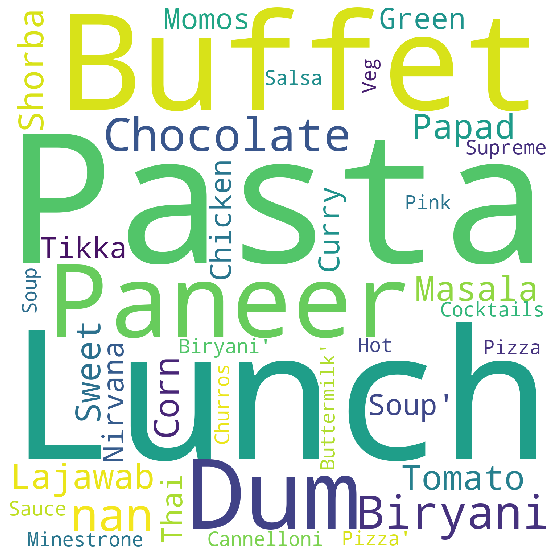

In [28]:
c1 = ''.join(str(rest_data['dish_liked'].values))
from wordcloud import WordCloud
plt.figure(figsize=(10,10))
wordcloud = WordCloud(max_font_size=None,background_color='white',collocations=False,width=1500,height=1500).generate(c1)
plt.imshow(wordcloud)
plt.axis("off")

<u> 10. Popular cuisines in the city </u>

(-0.5, 999.5, 999.5, -0.5)

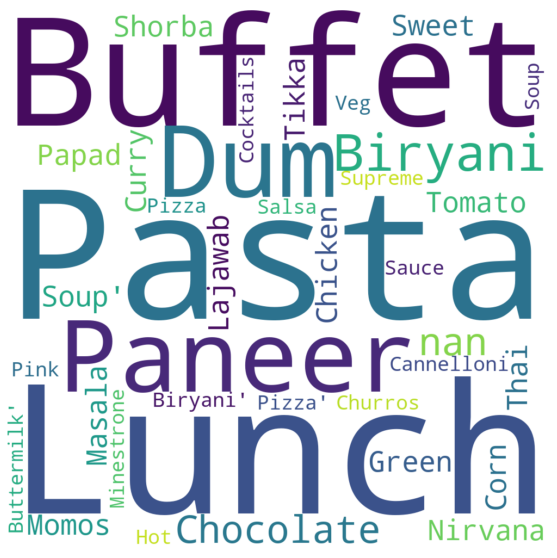

In [29]:
c2 = ''.join(str(rest_data['dish_liked'].values))
from wordcloud import WordCloud
plt.figure(figsize=(10,10))
wordcloud = WordCloud(max_font_size=None,background_color='white',collocations=False,width=1000,height=1000).generate(c2)
plt.imshow(wordcloud,interpolation='bilinear')
plt.axis("off")

<u> 11. Largest Resturant chains in the city </u>

In [31]:
chain = rest_data['name'].value_counts().head(25).to_frame()
chain['Resturant Names'] = chain.index
chain.rename(columns={'name':'Count'},inplace=True)
px.bar(chain,x='Resturant Names',y='Count')

<u1>12.Top 10 Cuisines </u1>

In [34]:
cuisines = rest_data['cuisines'].value_counts().head(10).to_frame()
cuisines['Cuisine names'] = cuisines.index
px.bar(cuisines,x='Cuisine names',y='cuisines')